# Setting Up Necessary Things

In [1]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline
bs = 32 # batch size
version = 2

In [2]:
!pip install -Uqq fastai

In [3]:
from fastai import *
from fastai.vision.all import *
from fastai.vision.widgets import *

In [4]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


In [5]:
%cd /content/drive/My Drive/MasterCourse_Project/Wildflower_Recognizer

/content/drive/My Drive/MasterCourse_Project/Wildflower_Recognizer


# Fetch Data

In [6]:
data_path = "data"
dblock = DataBlock(
    blocks=(ImageBlock, CategoryBlock),
    get_items=get_image_files,                        # get_image_files returns a list of all images in that path recursively by default
    splitter=RandomSplitter(valid_pct=0.1, seed=42),  # getting 90-10 train-validation split
    get_y=parent_label,                               # taking the folder name as labels
    item_tfms=Resize(128))                            # resizing to get the image of same shape

In [ ]:
dblock = dblock.new(item_tfms=RandomResizedCrop(224, min_scale=0.5), batch_tfms=aug_transforms())
dls = dblock.dataloaders(data_path, bs = bs)
torch.save(dls, f"dataloaders/Wildflower_dataloader_v{version}.pkl")

In [7]:
 dls = torch.load(f"dataloaders/Wildflower_dataloader_v{version}.pkl")

In [8]:
dls.train.vocab

['Alpine Aster', 'Alpine Forget-me-not', 'Beach Evening Primrose', 'Beach Morning Glory', 'Black-eyed Susan', 'Bluebell', 'Columbine', 'Daisy', 'Desert Marigold', 'Desert Sunflower', 'Indian Paintbrush', "Lady's Slipper Orchid", 'Lupine', 'Ocotillo', 'Pitcher Plant', 'Prairie Clover', 'Prairie Phlox', 'Prickly Pear', "Queen Anne's Lace", 'Seaside Goldenrod', 'Sunflower', 'Swamp Milkweed', 'Trillium', 'Water Lily', 'Wild Bergamot']

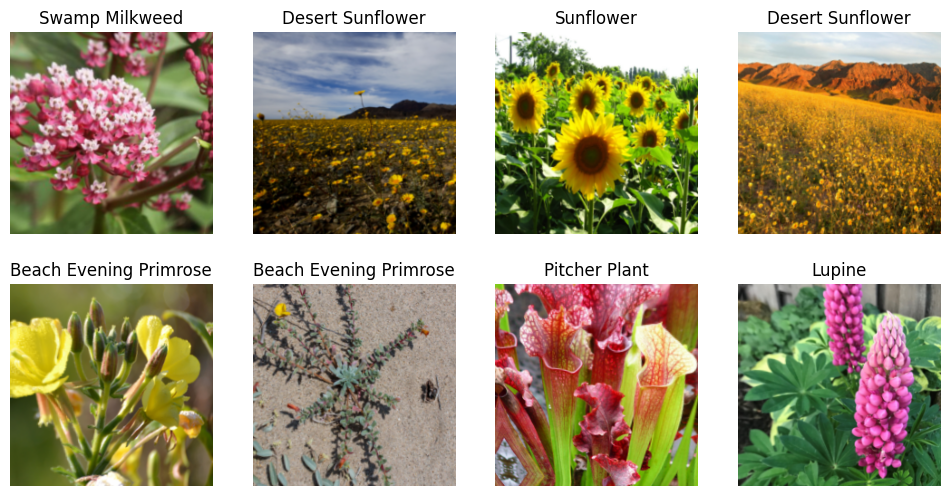

In [ ]:
dls.train.show_batch(max_n=8, nrows=2)

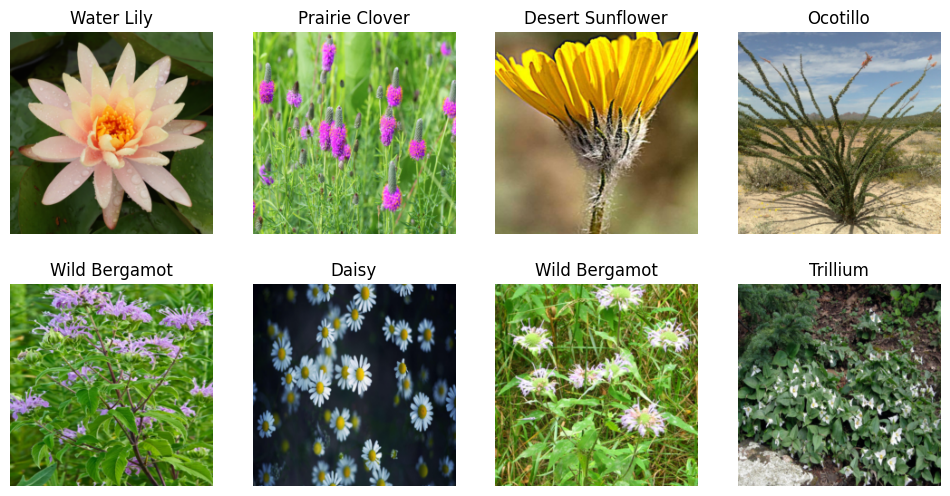

In [ ]:
dls.valid.show_batch(max_n=8, nrows=2)

# Training and Data Cleaning

In [ ]:
model_path = "models"

In [ ]:
model = vision_learner(dls, resnet34, metrics=[error_rate,accuracy])

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet34_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet34_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet34-b627a593.pth" to /root/.cache/torch/hub/checkpoints/resnet34-b627a593.pth
100%|██████████| 83.3M/83.3M [00:01<00:00, 71.0MB/s]


In [ ]:
model.load(f"Wildflower-recognizer-v{version-2}")

In [ ]:
model.fine_tune(3) # version 2

epoch,train_loss,valid_loss,error_rate,accuracy,time
0,0.261454,0.137976,0.041995,0.958005,23:47


/usr/local/lib/python3.10/dist-packages/PIL/Image.py:975: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


epoch,train_loss,valid_loss,error_rate,accuracy,time
0,0.278798,0.316215,0.086614,0.913386,33:48
1,0.261610,0.136336,0.049869,0.950131,33:58
2,0.155700,0.117116,0.036745,0.963255,34:21


/usr/local/lib/python3.10/dist-packages/PIL/Image.py:975: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/PIL/Image.py:975: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/PIL/Image.py:975: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


In [ ]:
model.save(f"Wildflower-recognizer-v{version}")

Path('models/Wildflower-recognizer-v2.pth')

In [ ]:
# model.load(f"Wildflower-recognizer-v{version}")

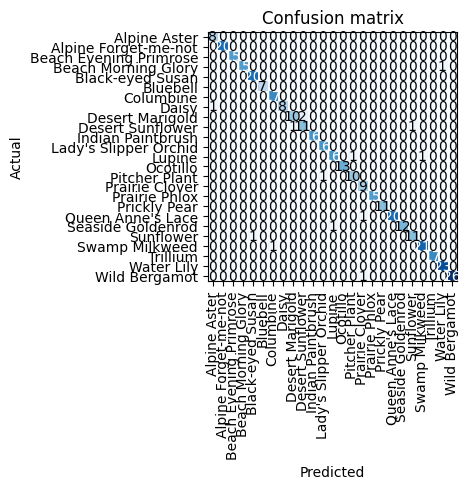

In [ ]:
interp = ClassificationInterpretation.from_learner(model)
interp.plot_confusion_matrix()

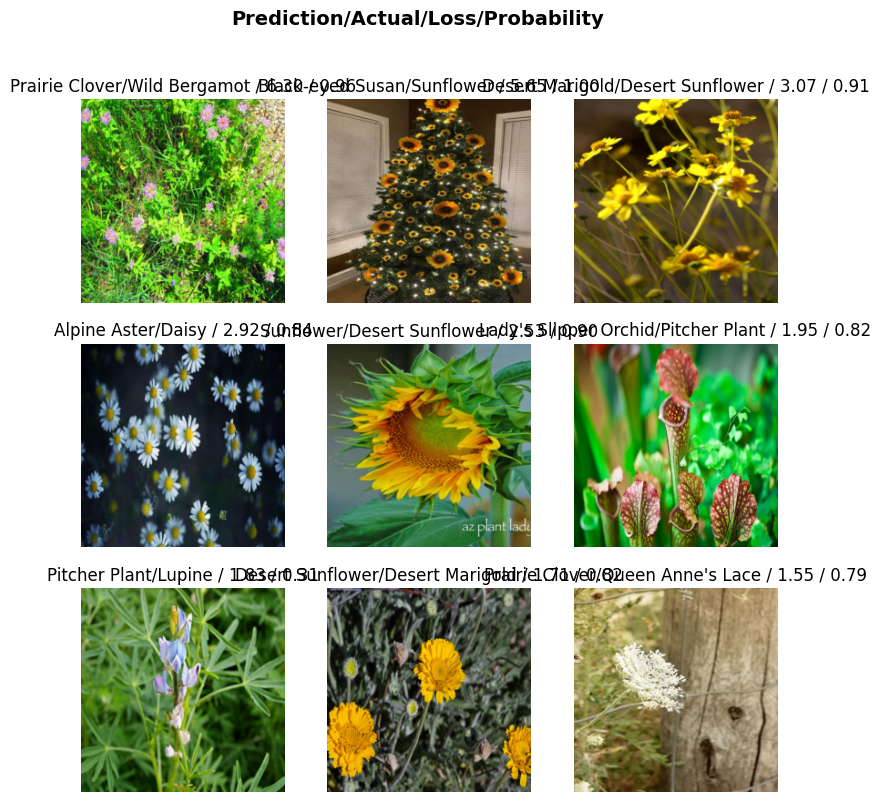

In [ ]:
interp.plot_top_losses(9, nrows=3)

In [ ]:
cleaner = ImageClassifierCleaner(model)
cleaner

/usr/local/lib/python3.10/dist-packages/PIL/Image.py:975: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


In [ ]:
cleaner.delete()

In [ ]:
cleaner.change()

In [ ]:
for idx in cleaner.delete(): cleaner.fns[idx].unlink()                                    # delete irrelevant data
for idx,flower in cleaner.change(): shutil.move(str(cleaner.fns[idx]), f"{data_path}/{flower}") # change the directory

# Export model for inference

In [ ]:
model.export(f"{model_path}/Wildflower-recognizer-v{version}.pkl")